In [4]:
# import the necessary packages
import numpy as np
import time
import cv2
import os
from os import listdir
from os.path import isfile, join
from matplotlib import pyplot as plt

# Define our imshow function
def imshow(title = "Image", image = None, size = 10):
    w, h = image.shape[0], image.shape[1]
    aspect_ratio = w/h
    plt.figure(figsize=(size * aspect_ratio,size))
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.show()

# Download and unzip our images and YOLO files

!unzip -qq /content/NeuralStyleTransfer.zip

In [5]:
# Implementing neural style transfer using the pretrained model

# loading the pretrained t7 neural transfer models
model_file_path = "/content/NeuralStyleTransfer/models"
model_file_paths = [f for f in listdir(model_file_path) if isfile(join(model_file_path, f))]


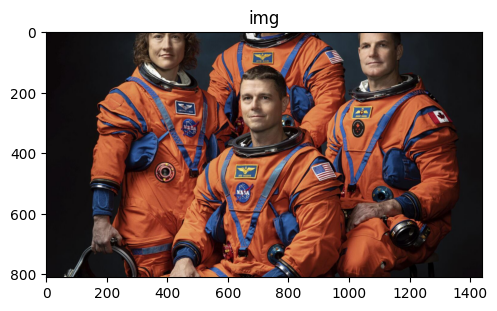

In [6]:
# loading the test image

img = cv2.imread('/content/astronaut.jpeg')
imshow('img', img)

1. Using Model: starry_night


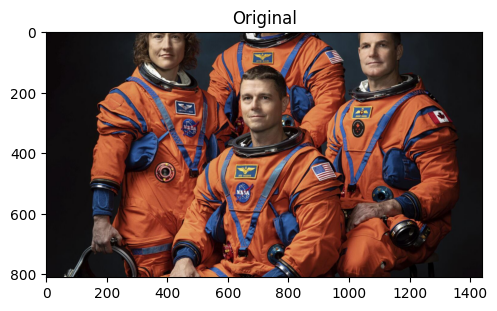

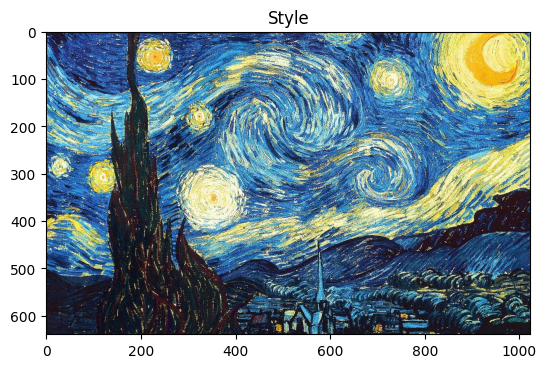

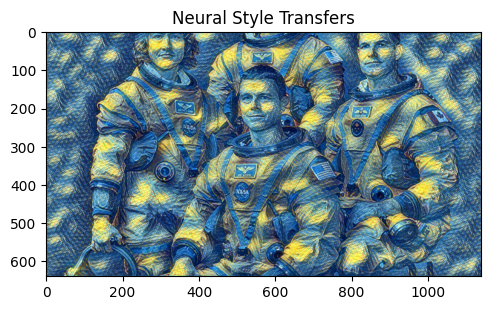

2. Using Model: the_wave


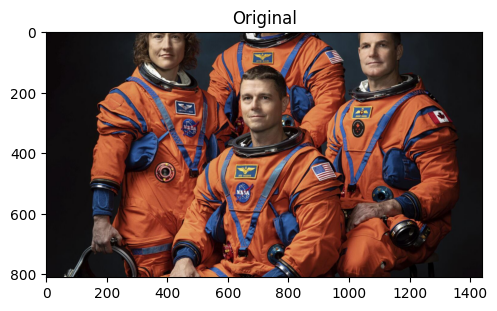

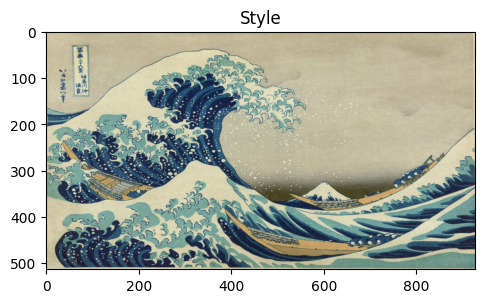

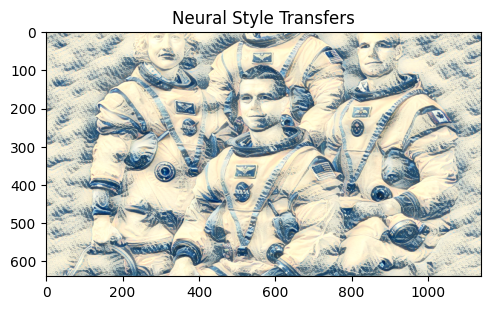

3. Using Model: mosaic


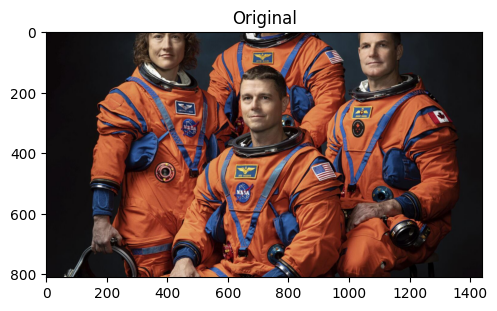

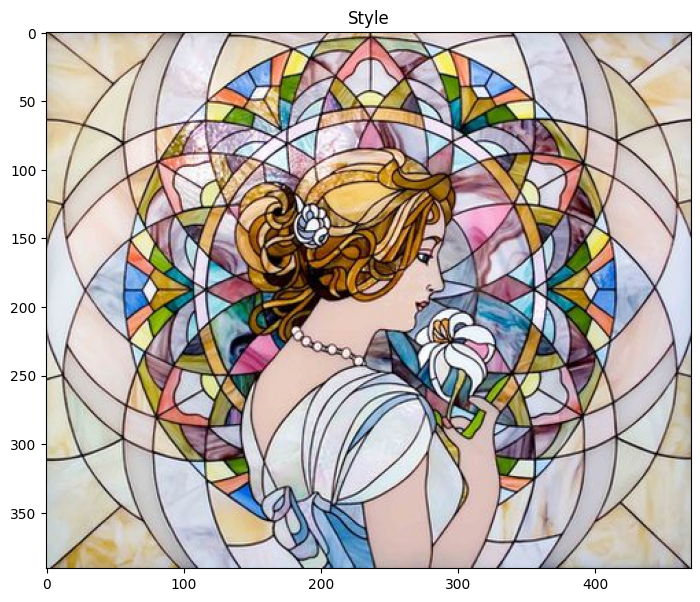

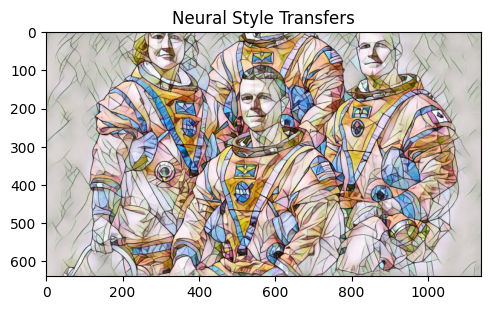

4. Using Model: composition_vii


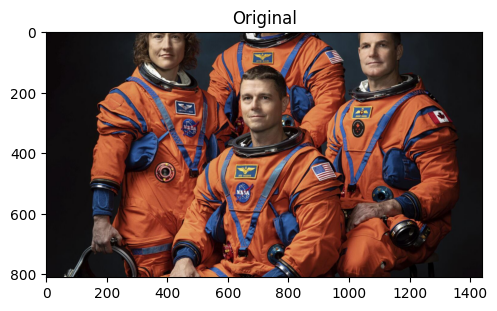

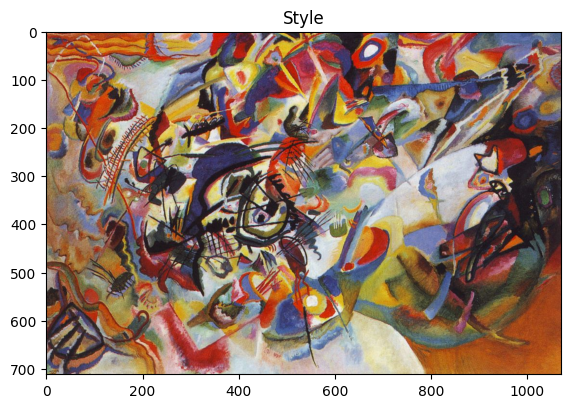

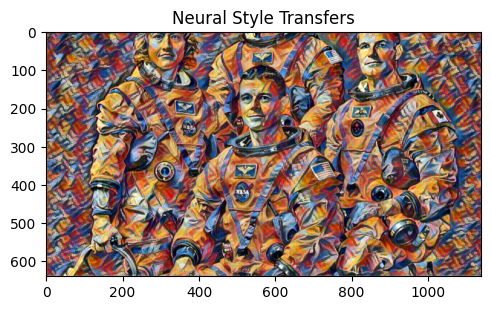

5. Using Model: candy


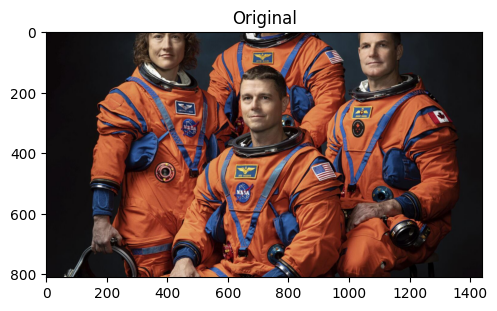

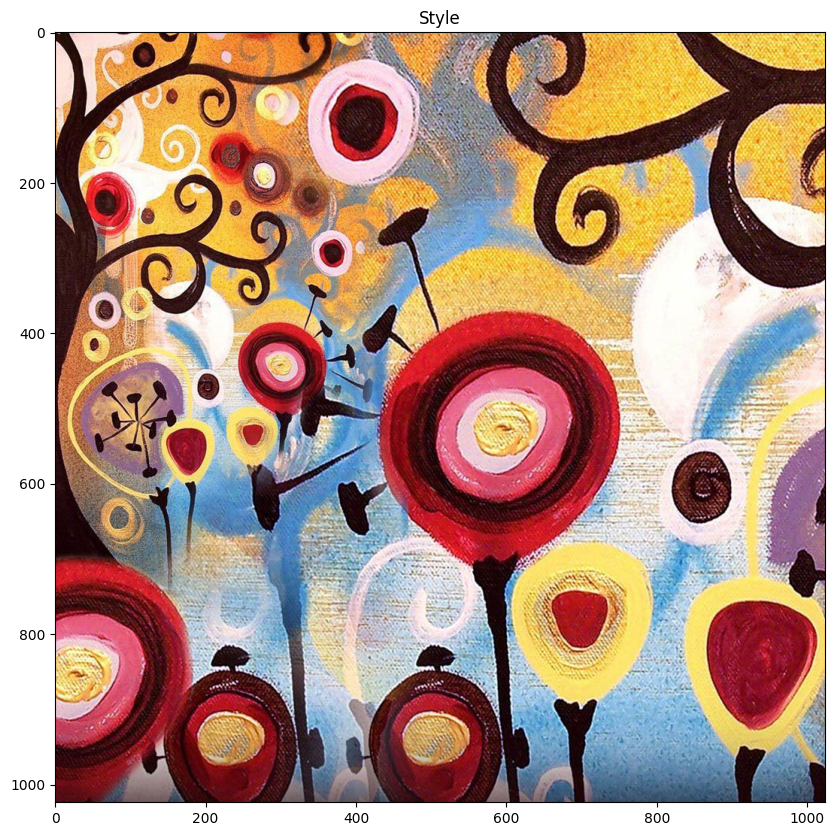

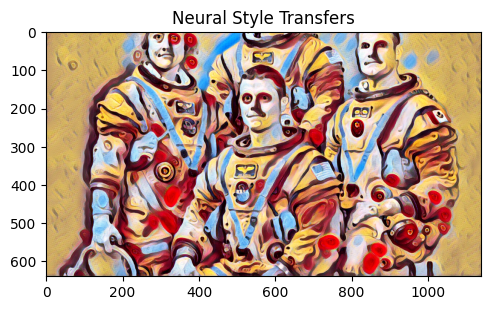

6. Using Model: udnie


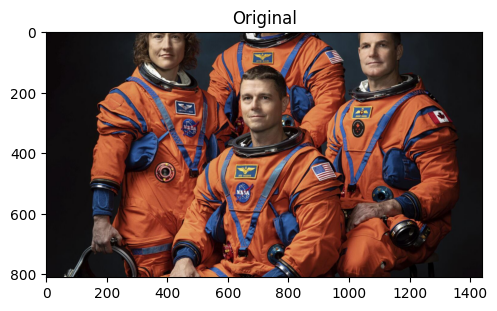

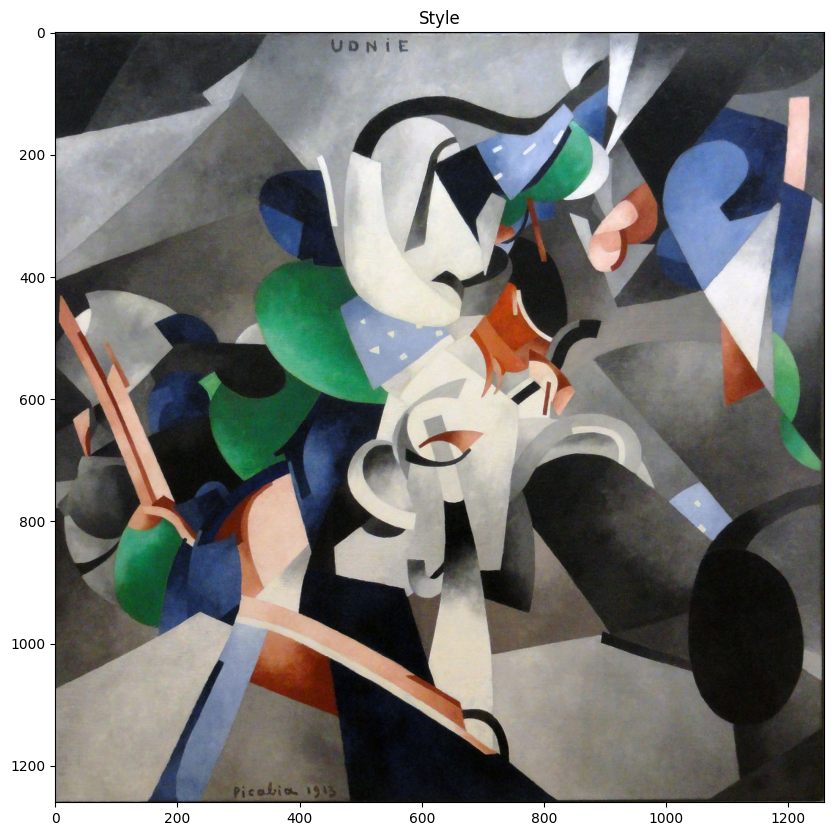

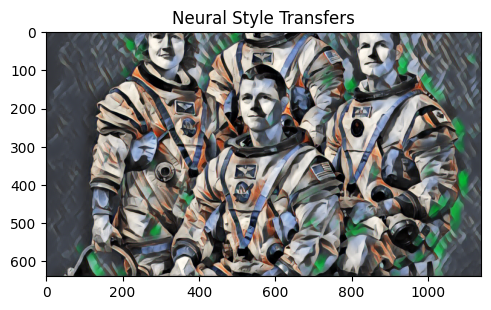

7. Using Model: feathers


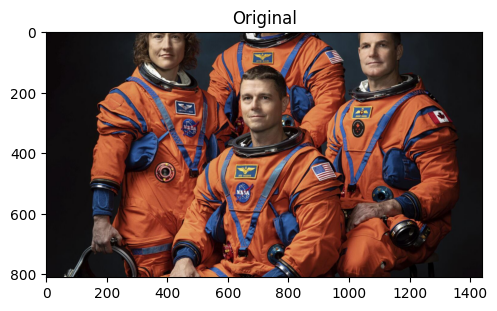

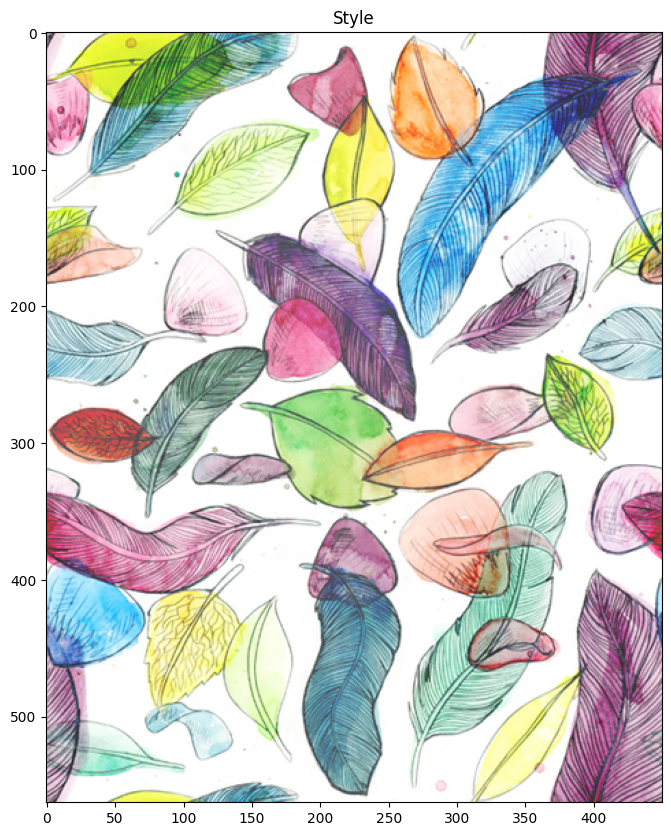

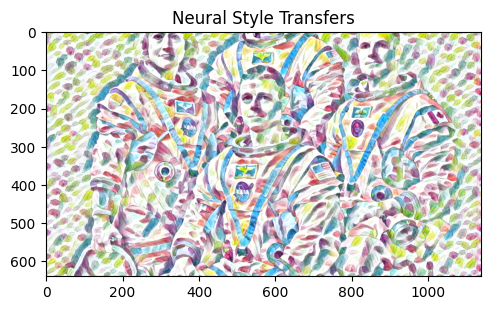

8. Using Model: the_scream


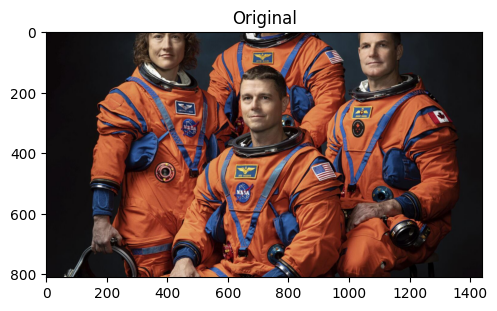

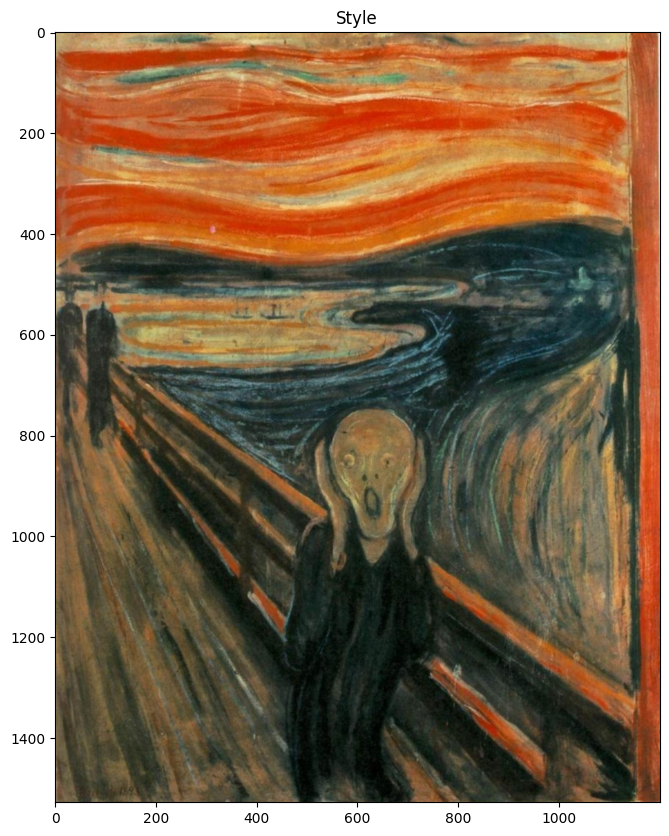

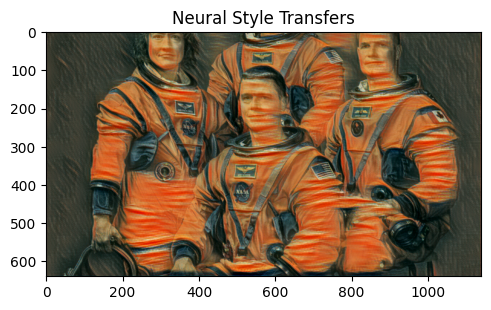

9. Using Model: la_muse


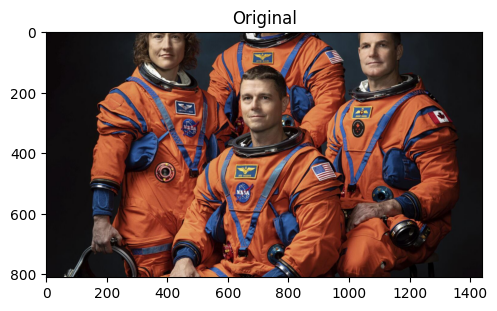

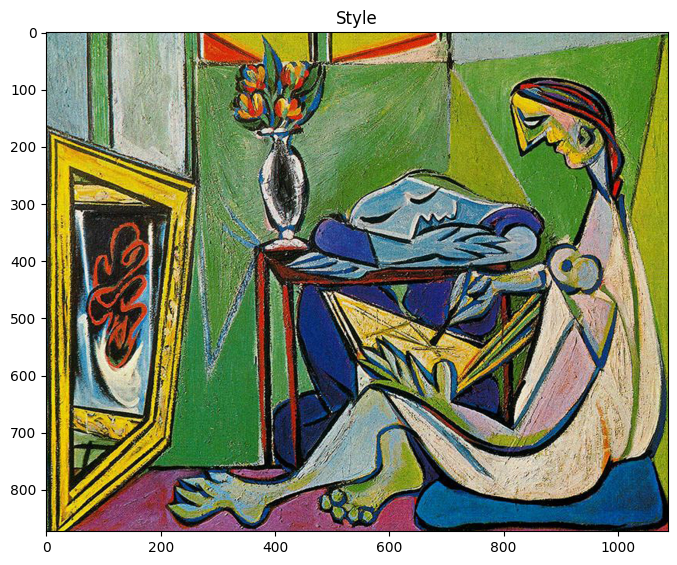

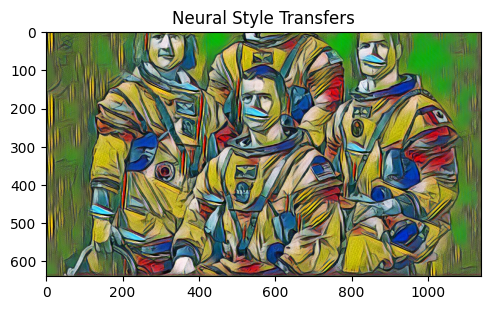

In [9]:
# looping through all the models and applying all model styles to our image

for (i,model) in  enumerate(model_file_paths):
  # print the model being used
  print(str(i+1) + ". Using Model: " + str(model)[:-3])
  style = cv2.imread("NeuralStyleTransfer/art/"+str(model)[:-3]+".jpg")

  # loading our neural style transfer model
  neuralStyleModel = cv2.dnn.readNetFromTorch(os.path.join(model_file_path,model))

  # Let's resize to a fixed height of 640 (feel free to change)
  height, width = int(img.shape[0]), int(img.shape[1])
  newWidth = int((640 / height) * width)
  resizedImg = cv2.resize(img, (newWidth, 640), interpolation = cv2.INTER_AREA)

  # Create our blob from the image and then perform a forward pass run of the network
  inpBlob = cv2.dnn.blobFromImage(resizedImg, 1.0, (newWidth, 640), (103.939, 116.779, 123.68), swapRB=False, crop=False)

  neuralStyleModel.setInput(inpBlob)
  output = neuralStyleModel.forward()

  # Reshaping the output tensor, adding back  the mean subtraction and re-ordering the channels
  output = output.reshape(3, output.shape[2], output.shape[3])
  output[0] += 103.939
  output[1] += 116.779
  output[2] += 123.68
  output /= 255
  output = output.transpose(1, 2, 0)

  #Display our original image, the style being applied and the final Neural Style Transfer
  imshow("Original", img)
  imshow("Style", style)
  imshow("Neural Style Transfers", output)

In [11]:
# Load our t7 neural transfer models
model_file_path = "/content/NeuralStyleTransfer/models/ECCV16"
model_file_paths = [f for f in listdir(model_file_path) if isfile(join(model_file_path, f))]

# Load our test image
img = cv2.imread("/content/astronaut.jpeg")

1. Using Model: starry_night


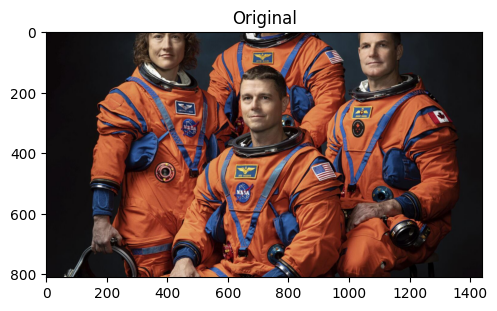

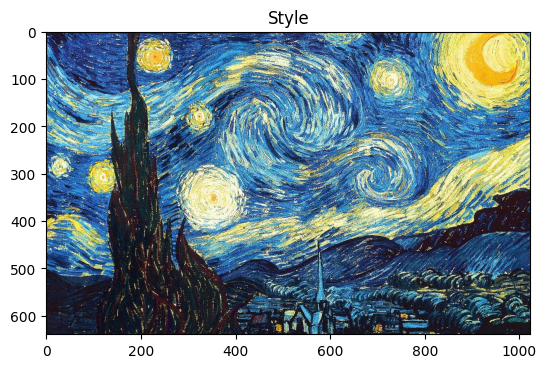

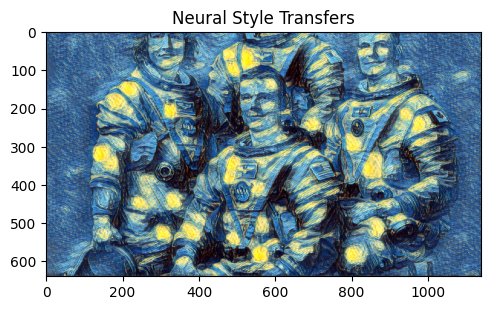

2. Using Model: the_wave


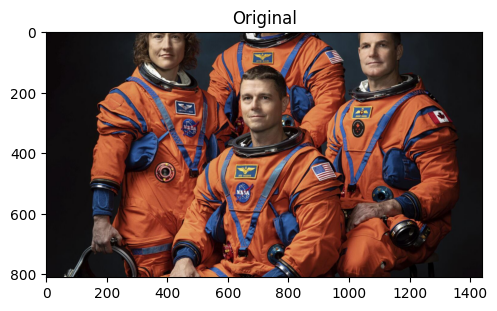

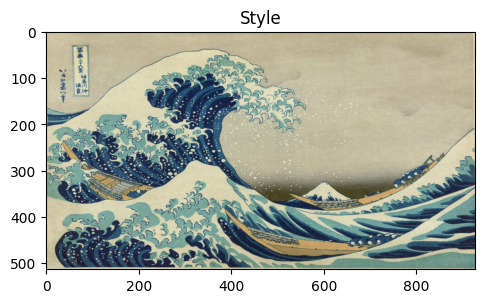

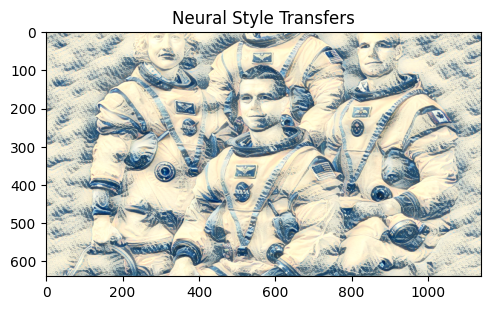

3. Using Model: composition_vii


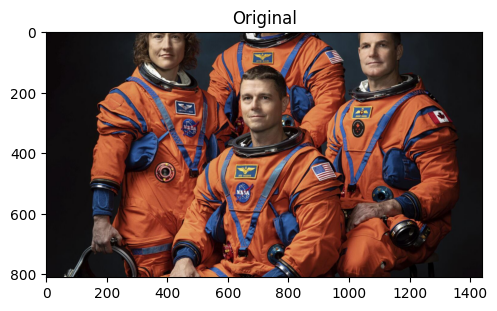

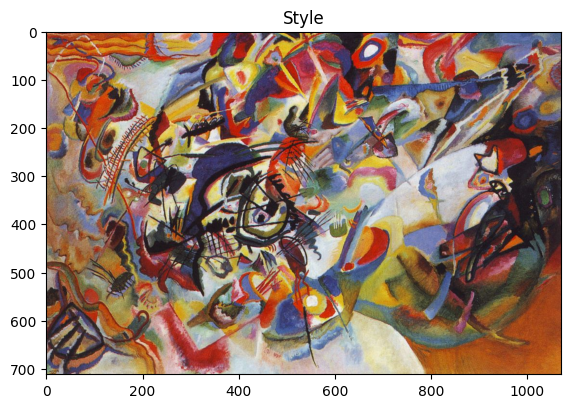

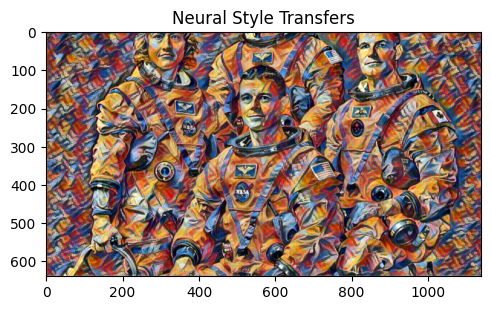

4. Using Model: la_muse


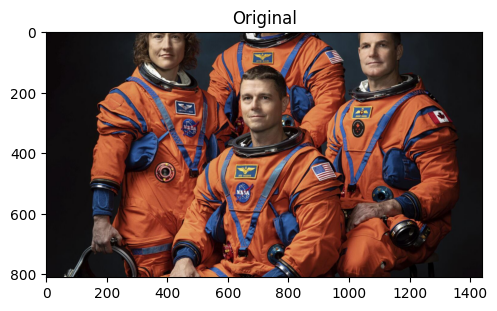

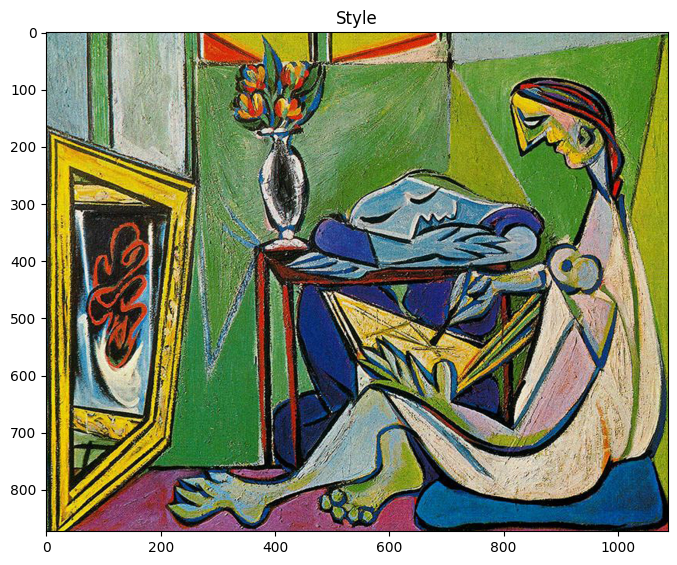

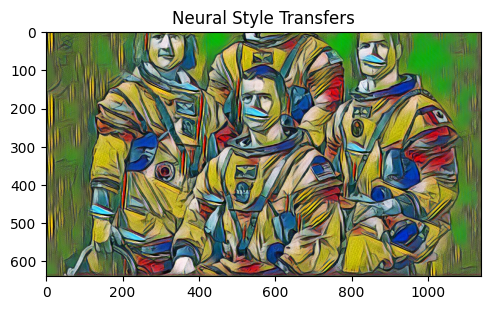

In [14]:
# Loop through and applying each model style our input image
for (i,model) in enumerate(model_file_paths):
    # print the model being used
    print(str(i+1) + ". Using Model: " + str(model)[:-3])
    style = cv2.imread("NeuralStyleTransfer/art/"+str(model)[:-3]+".jpg")
    # loading our neural style transfer model
    neuralStyleModel = cv2.dnn.readNetFromTorch(os.path.join(model_file_path,model))

    # Let's resize to a fixed height of 640 (feel free to change)
    height, width = int(img.shape[0]), int(img.shape[1])
    newWidth = int((640 / height) * width)
    resizedImg = cv2.resize(img, (newWidth, 640), interpolation = cv2.INTER_AREA)

    # Create our blob from the image and then perform a forward pass run of the network
    inpBlob = cv2.dnn.blobFromImage(resizedImg, 1.0, (newWidth, 640), (103.939, 116.779, 123.68), swapRB=False, crop=False)

    neuralStyleModel.setInput(inpBlob)
    output = neuralStyleModel.forward()

    # Reshaping the output tensor, adding back  the mean subtraction and re-ordering the channels
    output = output.reshape(3, output.shape[2], output.shape[3])
    output[0] += 103.939
    output[1] += 116.779
    output[2] += 123.68
    output /= 255
    output = output.transpose(1, 2, 0)

    #Display our original image, the style being applied and the final Neural Style Transfer
    imshow("Original", img)
    imshow("Style", style)
    imshow("Neural Style Transfers", output)

In [15]:
# using neural style transfer on a video

# Load our t7 neural transfer models
model_file_path = "/content/NeuralStyleTransfer/models/ECCV16/starry_night.t7"


In [16]:
# loading the video

cap = cv2.VideoCapture('/content/NeuralStyleTransfer/dj.mp4')

# get the height and width of the video
w = int(cap.get(3))
h = int(cap.get(4))

# Define the codec and create VideoWriter object. The output is stored in '*.avi' file.
out = cv2.VideoWriter('NST_Starry_Night.avi', cv2.VideoWriter_fourcc('M','J','P','G'), 30, (w, h))

In [19]:
# Loop through and applying each model style our input image
#for (i,model) in enumerate(model_file_paths):
style = cv2.imread("/content/NeuralStyleTransfer/art/starry_night.jpg")
i = 0
while(1):
  ret , img = cap.read()

  if ret == True:
      i += 1
      print("Completed {} Frame(s)".format(i))
      # loading our neural style transfer model
      neuralStyleModel = cv2.dnn.readNetFromTorch(model_file_path)

      # Let's resize to a fixed height of 640 (feel free to change)
      height, width = int(img.shape[0]), int(img.shape[1])
      newWidth = int((640 / height) * width)
      resizedImg = cv2.resize(img, (newWidth, 640), interpolation = cv2.INTER_AREA)

      # Create our blob from the image and then perform a forward pass run of the network
      inpBlob = cv2.dnn.blobFromImage(resizedImg, 1.0, (newWidth, 640),
                                (103.939, 116.779, 123.68), swapRB=False, crop=False)

      neuralStyleModel.setInput(inpBlob)
      output = neuralStyleModel.forward()

      # Reshaping the output tensor, adding back  the mean subtraction
      # and re-ordering the channels
      output = output.reshape(3, output.shape[2], output.shape[3])
      output[0] += 103.939
      output[1] += 116.779
      output[2] += 123.68
      output /= 255
      output = output.transpose(1, 2, 0)

      #Display our original image, the style being applied and the final Neural Style Transfer
      #imshow("Original", img)
      #imshow("Style", style)
      #imshow("Neural Style Transfers", output)
      vid_output = (output * 255).astype(np.uint8)
      vid_output = cv2.resize(vid_output, (w, h), interpolation = cv2.INTER_AREA)
      out.write(vid_output)
  else:
    break

cap.release()
out.release()

Completed 1 Frame(s)
Completed 2 Frame(s)
Completed 3 Frame(s)
Completed 4 Frame(s)
Completed 5 Frame(s)
Completed 6 Frame(s)
Completed 7 Frame(s)
Completed 8 Frame(s)
Completed 9 Frame(s)
Completed 10 Frame(s)
Completed 11 Frame(s)
Completed 12 Frame(s)
Completed 13 Frame(s)
Completed 14 Frame(s)
Completed 15 Frame(s)
Completed 16 Frame(s)
Completed 17 Frame(s)
Completed 18 Frame(s)
Completed 19 Frame(s)
Completed 20 Frame(s)
Completed 21 Frame(s)
Completed 22 Frame(s)
Completed 23 Frame(s)
Completed 24 Frame(s)
Completed 25 Frame(s)
Completed 26 Frame(s)
Completed 27 Frame(s)
Completed 28 Frame(s)
Completed 29 Frame(s)
Completed 30 Frame(s)
Completed 31 Frame(s)
Completed 32 Frame(s)
Completed 33 Frame(s)


In [20]:
# now we display the video

# converting the video file to .MP4
!ffmpeg -i /content/NST_Starry_Night.avi NST_Starry_Night.mp4 -y

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

In [21]:
from IPython.display import HTML
from base64 import b64encode

video_path = '/content/NST_Starry_Night.mp4'

mp4 = open(video_path, "rb").read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML(f"""
<video width=600 controls><source src="{data_url}" type="video/mp4">
</video>""")